# 🔍 Optimizing registration

In [45]:
%matplotlib inline

In [56]:
import torch
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import pandas as pd
import seaborn as sns

from IPython.display import HTML
from matplotlib.animation import ArtistAnimation
from tqdm import tqdm

from diffdrr import read_dicom, DRR
from diffdrr.metrics import XCorr2
from diffdrr.visualization import animate, plot_drr

# Read in the volume
volume, spacing = read_dicom("../DiffDRR/data/cxr", True)

np.random.seed(825)

In [57]:
def converged(df):
    return df["loss"].iloc[-1] <= -0.999

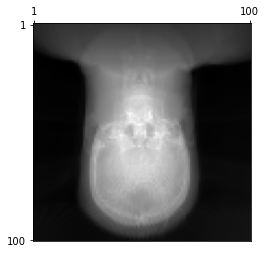

In [58]:
# Make the ground truth X-ray
SDR = 150.0
HEIGHT = 100
DELX = 5e-2

bx, by, bz = np.array(volume.shape) * np.array(spacing) / 2
true_params = {
    "sdr": SDR,
    "theta": torch.pi,
    "phi": 0,
    "gamma": torch.pi / 2,
    "bx": bx,
    "by": by,
    "bz": bz,
}

drr = DRR(volume, spacing, height=HEIGHT, delx=DELX, device=device.type)
ground_truth = drr(**true_params)

plot_drr(ground_truth)
plt.show()

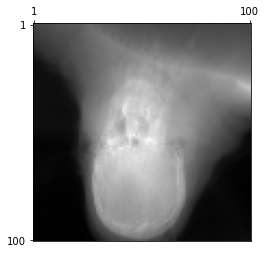

In [59]:
# Make a random DRR
def get_initial_parameters(true_params):
    sdr = true_params["sdr"]
    theta = true_params["theta"] + np.random.uniform(-np.pi / 4, np.pi / 4)
    phi = true_params["phi"] + np.random.uniform(-np.pi / 3, np.pi / 3)
    gamma = true_params["gamma"] + np.random.uniform(-np.pi / 3, np.pi / 3)
    bx = true_params["bx"] + np.random.uniform(-30.0, 31.0)
    by = true_params["by"] + np.random.uniform(-30.0, 31.0)
    bz = true_params["bz"] + np.random.uniform(-30.0, 31.0)
    return sdr, theta, phi, gamma, bx, by, bz


sdr, theta, phi, gamma, bx, by, bz = get_initial_parameters(true_params)
est = drr(sdr, theta, phi, gamma, bx, by, bz)  # Initialize the DRR generator

plot_drr(est)
plt.show()

In [62]:
def optimize(
    drr,
    ground_truth,
    lr_rotations=5.3e-2,
    lr_translations=7.5e1,
    momentum=0,
    dampening=0,
    n_itrs=250
):
    criterion = XCorr2(zero_mean_normalized=True)
    optimizer = torch.optim.SGD(
        [
            {"params": [drr.rotations], "lr": lr_rotations},
            {"params": [drr.translations], "lr": lr_translations},
        ],
        momentum=momentum,
        dampening=dampening,
    )
    
    params = []
    for itr in tqdm(range(n_itrs)):
        estimate = drr()
        theta, phi, gamma = drr.rotations.squeeze()
        bx, by, bz = drr.translations.squeeze()
        params.append([i.item() for i in [theta, phi, gamma, bx, by, bz]])
        loss = -criterion(ground_truth[0], estimate[0])
        optimizer.zero_grad()
        loss.backward(retain_graph=True)
        optimizer.step()
        
        if loss < -0.999:
            tqdm.write(f"Converged in {itr} iterations")
            break
        
    return pd.DataFrame(params, columns=["theta", "phi", "gamma", "bx", "by", "bz"])

In [63]:
# Base SGD
drr(sdr, theta, phi, gamma, bx, by, bz)
params_base = optimize(drr, ground_truth)

# SGD + momentum
drr(sdr, theta, phi, gamma, bx, by, bz)
params_momentum = optimize(drr, ground_truth, momentum=0.9)

# SGD + momentum + dampening
drr(sdr, theta, phi, gamma, bx, by, bz)
params_momentum_dampen = optimize(drr, ground_truth, momentum=0.9, dampening=0.1)

 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 176/250 [04:27<01:52,  1.52s/it]


Converged in 176 iterations


 22%|██████████████████████████████████▉                                                                                                                         | 56/250 [01:26<05:00,  1.55s/it]


Converged in 56 iterations


 17%|██████████████████████████▊                                                                                                                                 | 43/250 [01:04<05:09,  1.49s/it]

Converged in 43 iterations


In [64]:
def precompute_drrs(df, sdr, drr, ax, max_len=len(params_base)):
    imgs = []
    for idx, row in df.iterrows():
        params = row[["theta", "phi", "gamma", "bx", "by", "bz"]].values
        itr = drr(sdr, *params)
        img = plot_drr(itr, animated=True, ax=ax)
        if idx == 0:
            plot_drr(itr, ax=ax)
        imgs.append(img)
    for _ in range(max_len - len(df)):
        imgs.append(img)
    return imgs

In [65]:
fig, axs = plt.subplots(ncols=4, dpi=300, figsize=(10, 3), constrained_layout=True)

plot_drr(ground_truth, ax=axs[0])
imgs1 = precompute_drrs(params_base, SDR, drr, axs[1])
imgs2 = precompute_drrs(params_momentum, SDR, drr, axs[2])
imgs3 = precompute_drrs(params_momentum_dampen, SDR, drr, axs[3])
imgs = [[*ims] for ims in zip(imgs1, imgs2, imgs3)]

anim = ArtistAnimation(fig, imgs, interval=50, blit=True, repeat_delay=1000)
plt.close()

HTML(anim.to_jshtml())

## `SciPy` optimization algorithms

In [99]:
import scipy

In [100]:
PARAMS = []

def gradfree(geoparams, *optimparams):
    """
    optimparams = (drr, criterion, ground_truth, sdr)
    """
    theta, phi, gamma = geoparams[:3]
    bx, by, bz = geoparams[3:]
    estimate = drr(sdr, theta, phi, gamma, bx, by, bz)
    loss = -criterion(ground_truth[0], estimate[0]).item()
    
    PARAMS.append([loss, theta, phi, gamma, bx, by, bz])
    
    return loss

In [101]:
criterion = XCorr2(zero_mean_normalized=True)

In [104]:
x0 = [theta, phi, gamma, bx, by, bz]
args = [drr, criterion, ground_truth, sdr]
scipy.optimize.minimize(gradfree, x0, args, method="Nelder-Mead")
df = pd.DataFrame (PARAMS, columns = ['loss', 'theta', 'phi', 'gamma', 'bx', 'by', 'bz'])

In [112]:
print(df[:380:20])

         loss     theta       phi     gamma          bx          by  \
0   -0.847538  3.514158  0.450122  1.809743  277.556075  255.606213   
20  -0.884167  3.176842  0.459430  1.636030  275.998035  258.303292   
40  -0.896766  3.231315  0.399675  1.786749  270.950745  252.223352   
60  -0.951763  3.210130  0.318737  1.613811  266.582926  257.991403   
80  -0.974189  3.201895  0.185173  1.543613  260.514670  258.873262   
100 -0.986419  3.220381  0.033786  1.524493  254.677431  259.773555   
120 -0.993581  3.094192 -0.010801  1.592653  256.433340  253.510182   
140 -0.999448  3.135245  0.001687  1.577279  256.319278  255.962314   
160 -0.999825  3.136172  0.001600  1.569378  256.095197  255.996748   
180 -0.999914  3.139183  0.000197  1.568739  255.979046  256.114419   
200 -0.999949  3.140531  0.001875  1.569656  255.942753  256.050840   
220 -0.999963  3.141680  0.001614  1.570825  255.946943  256.088032   
240 -0.999984  3.141887 -0.000158  1.570784  255.940561  256.053679   
260 -0

In [116]:
HTML(animate(df[:200:2], sdr, drr))

Precomputing DRRs: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [01:26<00:00,  1.16it/s]
